In [2]:
import pandas as pd 
import holidays


In [3]:
import geopandas
import folium # package for making maps, please make sure to use a version older than 1.0.0.
import branca

In [4]:
pd.options.display.max_columns = None

In [5]:
df = pd.read_csv("../../../samples/processed/accidents_cleanV2.csv")

In [6]:
df.shape

(251894, 28)

In [7]:
df.columns

Index(['x', 'y', 'objectid', 'radicado', 'fecha', 'hora', 'dia', 'periodo',
       'clase', 'direccion', 'direccion_enc', 'cbml', 'tipo_geocod',
       'gravedad', 'barrio', 'comuna', 'diseno', 'dia_nombre', 'mes',
       'mes_nombre', 'x_magnamed', 'y_magnamed', 'longitud', 'latitud', 'file',
       'shape', 'fecha_incidente', 'hora_incidente'],
      dtype='object')

In [8]:
df.head()

,x,y,objectid,radicado,fecha,hora,dia,periodo,clase,direccion,direccion_enc,cbml,tipo_geocod,gravedad,barrio,comuna,diseno,dia_nombre,mes,mes_nombre,x_magnamed,y_magnamed,longitud,latitud,file,shape,fecha_incidente,hora_incidente
0,-75.602726,6.219016,211279,1423828,2014/01/01 00:00:00+00,02:20:00,1,2014,Choque,CR 80 CL 8,CR 080 008 000 00000,1611,Malla vial aproximada: CR 81-7,HERIDO,Loma de los Bernal,Belén,Tramo de via,MIÉRCOLES,1,NaN,831190.08,1179689.50,-75.602726,6.219016,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-01,7.0
1,-75.568185,6.260009,211280,1423839,2014/01/01 00:00:00+00,12:50:00,1,2014,Atropello,CR 53 CL 61,CR 053 061 000 00000,1003,Malla vial,HERIDO,Jesús Nazareno,La Candelaria,Tramo de via,MIÉRCOLES,1,NaN,835013.63,1184223.79,-75.568185,6.260009,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-01,5.0
2,-75.549943,6.264765,211281,1423840,2014/01/01 00:00:00+00,01:00:00,1,2014,Atropello,CR 39 CL 70,CR 039 070 000 00000,0308,Malla vial,HERIDO,Manrique Oriental,Manrique,Tramo de via,MIÉRCOLES,1,NaN,837032.71,1184749.86,-75.549943,6.264765,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-01,6.0
3,-75.607611,6.234327,211282,1423849,2014/01/01 00:00:00+00,12:37:00,1,2014,Atropello,CL 32 CR 84,CL 032 084 000 00000,1617,Malla vial,HERIDO,Las Mercedes,Belén,Tramo de via,MIÉRCOLES,1,NaN,830649.47,1181383.24,-75.607611,6.234327,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-01,5.0
4,-75.579685,6.299968,211283,1423890,2014/01/01 00:00:00+00,10:40:00,1,2014,Caída de Ocupante,CR 80 CL 101,CR 080 101 000 00000,0603,Malla vial,HERIDO,Doce de Octubre No.2,Doce de Octubre,Tramo de via,MIÉRCOLES,1,NaN,833740.78,1188643.80,-75.579685,6.299968,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-01,15.0


In [9]:
df.groupby(["cbml", "barrio"])["cbml"].count().sort_values(ascending=False)

cbml         barrio            
1019         La Candelaria         6182
0517         Caribe                5244
1507         Campo Amor            5153
1012         Perpetuo Socorro      4987
1105         Los Conquistadores    4460
                                   ... 
08080390014  Enciso                   1
08080540070  Enciso                   1
13100460018  San Javier               1
13090270005  San Javier No.1          1
1012         La Candelaria            1
Name: cbml, Length: 779, dtype: int64

In [10]:
df[df.cbml == "1108"]

,x,y,objectid,radicado,fecha,hora,dia,periodo,clase,direccion,direccion_enc,cbml,tipo_geocod,gravedad,barrio,comuna,diseno,dia_nombre,mes,mes_nombre,x_magnamed,y_magnamed,longitud,latitud,file,shape,fecha_incidente,hora_incidente
410,-75.596885,6.240613,211757,1424463,2014/01/06 00:00:00+00,06:30:00,6,2014,Choque,CR 76 CL 34,CR 076 034 000 00000,1108,Malla vial,SOLO DAÑOS,Laureles,Laureles Estadio,Tramo de via,LUNES,1,NaN,831836.79,1182078.44,-75.596885,6.240613,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-06,23.0
490,-75.595779,6.242462,211844,1424496,2014/01/07 00:00:00+00,01:30:00,7,2014,Choque,Tv 38 CR 73 A,TV 038 073 A 000 00000,1108,Malla vial,SOLO DAÑOS,Laureles,Laureles Estadio,Tramo de via,MARTES,1,NaN,831959.25,1182282.99,-75.595779,6.242462,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-07,18.0
1048,-75.594935,6.243236,212480,1425382,2014/01/13 00:00:00+00,06:30:00,13,2014,Choque,CR 73 A CL 39,CR 073 A 039 000 00000,1108,Malla vial,SOLO DAÑOS,Laureles,Laureles Estadio,Tramo de via,LUNES,1,NaN,832052.66,1182368.56,-75.594935,6.243236,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-13,23.0
1126,-75.599212,6.245482,212574,1425256,2014/01/14 00:00:00+00,03:30:00,14,2014,Choque,CR 79 CL 38,CR 079 038 000 00000,1108,EPM sin Interior,SOLO DAÑOS,Laureles,Laureles Estadio,Interseccion,MARTES,1,NaN,831579.25,1182617.01,-75.599212,6.245482,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-14,20.0
1153,-75.599281,6.245479,212602,1425276,2014/01/15 00:00:00+00,07:40:00,15,2014,Choque,CR 79 Tv 39,CR 079 039 000 00000,1108,Malla vial aproximada: CR 79-38,HERIDO,Laureles,Laureles Estadio,Glorieta,MIÉRCOLES,1,NaN,831571.64,1182616.71,-75.599281,6.245479,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-16,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251111,NaN,NaN,757168,1702252,2019/12/30 00:00:00+00,07:40:00,30,2019,Choque,TV 39 B CR 73 B,TV 039 B 073 B 000 00000,1108,Malla vial,Con heridos,Laureles,Laureles Estadio,Tramo de via,LUNES,12,DICIEMBRE,832083.32,1182499.89,-75.594658,6.244423,Accidentalidadgeorreferenciada2019.csv,NaN,NaN,NaN
251128,NaN,NaN,757230,1701316,2019/12/20 00:00:00+00,12:00:00,20,2019,Choque,TV 39 B CR 73 B,TV 039 B 073 B 000 00000,1108,Malla vial,Solo daños,Laureles,Laureles Estadio,Tramo de via,VIERNES,12,DICIEMBRE,832083.32,1182499.89,-75.594658,6.244423,Accidentalidadgeorreferenciada2019.csv,NaN,NaN,NaN
251193,NaN,NaN,757305,1701245,2019/12/24 00:00:00+00,09:00:00,24,2019,Choque,TV 39 DG 73 A,TV 039 073 A 000 00000,1108,Malla vial,Con heridos,Laureles,Laureles Estadio,Tramo de via,MARTES,12,DICIEMBRE,832049.32,1182364.84,-75.594965,6.243202,Accidentalidadgeorreferenciada2019.csv,NaN,NaN,NaN
251551,NaN,NaN,757944,1701045,2019/12/21 00:00:00+00,03:00:00,21,2019,Choque,CR 74 D CL 4,CR 074 D 004 000 00000,1108,Malla vial aproximada: CR 74-4,Solo daños,Laureles,Laureles Estadio,Interseccion,SÁBADO,12,DICIEMBRE,832170.33,1182579.20,-75.593872,6.245140,Accidentalidadgeorreferenciada2019.csv,NaN,NaN,NaN


In [11]:
df["fecha_dt"] = pd.to_datetime(df.fecha, format='%Y/%m/%d')
df.dia_nombre = df.dia_nombre.str.strip()

In [12]:
# create a new holiday column: "festivo"
col_holidays = holidays.COL(years = list(range(2014,2020))) # range(2014,2020) brings the years among 2014 and 2019
holidays_df = pd.DataFrame(col_holidays.keys()).rename(columns={0:"festivo"})
df["festivo"] = 0
df.loc[df["fecha_dt"].isin(list(holidays_df.festivo)), "festivo"] = 1

In [13]:
df[['comuna', 'gravedad']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 251894 entries, 0 to 251893
Data columns (total 2 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   comuna    251384 non-null  object
 1   gravedad  251894 non-null  object
dtypes: object(2)
memory usage: 3.8+ MB


In [14]:
#df["comuna"].value_counts(dropna=False)[0:30]
df.loc[df.comuna.isna() | df.comuna.isin(["In", "Sin Inf", "AU", "SN", "0"]), "comuna"] = "Sin Inf"
#df[df.comuna.isna() | df.comuna.isin(["In", "Sin Inf", "AU", "SN", "0"])]

In [15]:
df.comuna.value_counts()[0:30]

La Candelaria                                 52795
Laureles Estadio                              28391
Castilla                                      25359
El Poblado                                    20868
Guayabal                                      18349
Belén                                         16608
Robledo                                       16553
Aranjuez                                      14975
Buenos Aires                                   9554
La América                                     8243
Manrique                                       7790
Doce de Octubre                                6951
Villa Hermosa                                  6688
San Javier                                     4436
Popular                                        3662
Santa Cruz                                     3392
Corregimiento de San Antonio de Prado          2558
Corregimiento de San Cristóbal                 2482
Corregimiento de Santa Elena                    907
Sin Inf     

In [16]:
#df.gravedad[] = df.gravedad.str.upper()
df.gravedad = df.gravedad.str.replace("Con heridos", "HERIDO")
df.gravedad = df.gravedad.str.replace("Solo daños", "SOLO DAÑOS")
df.gravedad = df.gravedad.str.replace("Con muertos", "MUERTO")
df.gravedad.value_counts(dropna=False)
#df.loc[df.gravedad==]

HERIDO        137200
SOLO DAÑOS    113229
MUERTO          1465
Name: gravedad, dtype: int64

In [17]:
df.groupby(["comuna", "gravedad"])["gravedad"].count().reset_index(name="conteo").sort_values(by="conteo", ascending=False)[0:30]

,comuna,gravedad,conteo
69,La Candelaria,SOLO DAÑOS,28692
67,La Candelaria,HERIDO,23788
24,Castilla,HERIDO,14803
80,Laureles Estadio,SOLO DAÑOS,14726
78,Laureles Estadio,HERIDO,13539
51,El Poblado,SOLO DAÑOS,13147
97,Robledo,HERIDO,10716
26,Castilla,SOLO DAÑOS,10403
5,Aranjuez,HERIDO,9519
57,Guayabal,HERIDO,9298


In [18]:
import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

In [19]:
?sns.lineplot

Signature:
sns.lineplot(
    x=None,
    y=None,
    hue=None,
    size=None,
    style=None,
    data=None,
    palette=None,
    hue_order=None,
    hue_norm=None,
    sizes=None,
    size_order=None,
    size_norm=None,
    dashes=True,
    markers=None,
    style_order=None,
    units=None,
    estimator='mean',
    ci=95,
    n_boot=1000,
    seed=None,
    sort=True,
    err_style='band',
    err_kws=None,
    legend='brief',
    ax=None,
    **kwargs,
)
Docstring:
Draw a line plot with possibility of several semantic groupings.

The relationship between ``x`` and ``y`` can be shown for different subsets
of the data using the ``hue``, ``size``, and ``style`` parameters. These
parameters control what visual semantics are used to identify the different
subsets. It is possible to show up to three dimensions independently by
using all three semantic types, but this style of plot can be hard to
interpret and is often ineffective. Using redundant semantics (i.e. both
``hue`` and ``styl

In [20]:
df.groupby(["fecha_dt", "festivo"])["fecha_dt"].count().reset_index(name="conteo")

,fecha_dt,festivo,conteo
0,2014-01-01 00:00:00+00:00,1,74
1,2014-01-02 00:00:00+00:00,0,72
2,2014-01-03 00:00:00+00:00,0,93
3,2014-01-04 00:00:00+00:00,0,68
4,2014-01-05 00:00:00+00:00,0,67
...,...,...,...
2186,2019-12-27 00:00:00+00:00,0,92
2187,2019-12-28 00:00:00+00:00,0,92
2188,2019-12-29 00:00:00+00:00,0,76
2189,2019-12-30 00:00:00+00:00,0,116


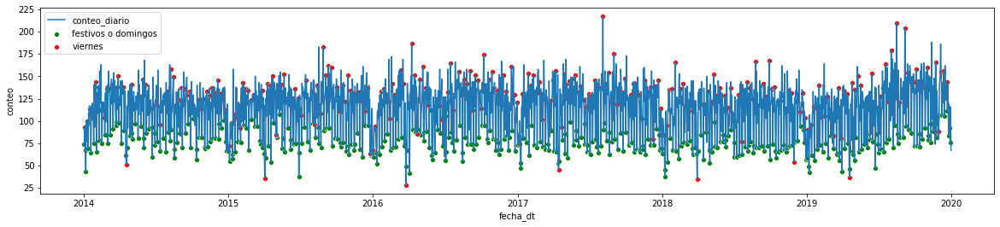

In [21]:
fig, ax = plt.subplots(figsize=(20, 4))
accidents_per_day = df.groupby(["fecha_dt", "festivo", "dia_nombre"])["fecha_dt"].count().reset_index(name="conteo")
# Enhanced line plot for electricity generation over time

sns.lineplot(x=accidents_per_day.fecha_dt.dt.date, y=accidents_per_day["conteo"])

sns.scatterplot(x=accidents_per_day[(accidents_per_day.festivo==1) | (accidents_per_day.dia_nombre=="DOMINGO")].fecha_dt.dt.date, 
                y=accidents_per_day[(accidents_per_day.festivo==1) | (accidents_per_day.dia_nombre=="DOMINGO")]["conteo"], 
                color="g")

sns.scatterplot(x=accidents_per_day[accidents_per_day.dia_nombre=="VIERNES"].fecha_dt.dt.date, 
                y=accidents_per_day[accidents_per_day.dia_nombre=="VIERNES"]["conteo"], 
                color="r")

plt.legend(["conteo_diario", "festivos o domingos", "viernes"])

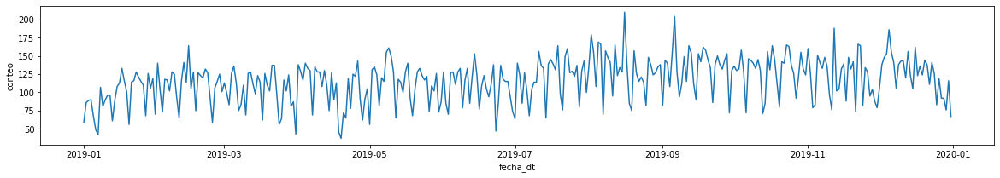

In [22]:
fig, ax = plt.subplots(figsize=(20, 3))
accidents_per_day = df[(df.fecha_dt.dt.year==2019) ].groupby("fecha_dt")["fecha_dt"].count().reset_index(name="conteo")
# Enhanced line plot for electricity generation over time
sns.lineplot(x=accidents_per_day.fecha_dt.dt.date, y=accidents_per_day["conteo"])

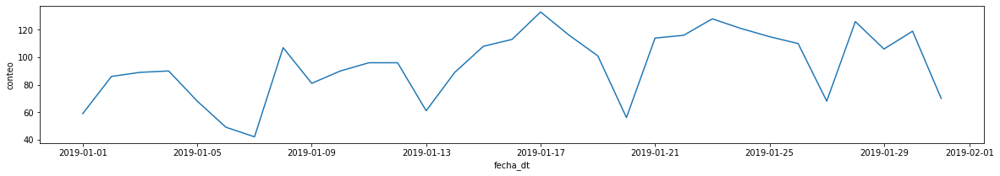

In [23]:
fig, ax = plt.subplots(figsize=(20, 3))
accidents_per_day = df[(df.fecha_dt.dt.year==2019) & (df.fecha_dt.dt.month==1) ].groupby("fecha_dt")["fecha_dt"].count().reset_index(name="conteo")

sns.lineplot(x=accidents_per_day.fecha_dt.dt.date, y=accidents_per_day["conteo"])

In [24]:
?df.pivot

Signature: df.pivot(index=None, columns=None, values=None) -> 'DataFrame'
Docstring:
Return reshaped DataFrame organized by given index / column values.

Reshape data (produce a "pivot" table) based on column values. Uses
unique values from specified `index` / `columns` to form axes of the
resulting DataFrame. This function does not support data
aggregation, multiple values will result in a MultiIndex in the
columns. See the :ref:`User Guide <reshaping>` for more on reshaping.

Parameters
----------
index : str or object, optional
    Column to use to make new frame's index. If None, uses
    existing index.
columns : str or object
    Column to use to make new frame's columns.
values : str, object or a list of the previous, optional
    Column(s) to use for populating new frame's values. If not
    specified, all remaining columns will be used and the result will
    have hierarchically indexed columns.

    .. versionchanged:: 0.23.0
       Also accept list of column names.

Returns


In [25]:
pivot_year_month = df.pivot_table(index='mes',columns='periodo', values="radicado", aggfunc=lambda x: x.count())

Text(0.5, 1.0, 'Number of Accidents per Months and Years')

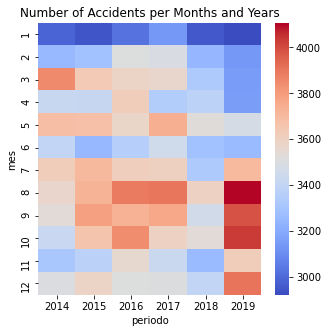

In [26]:
fig, ax = plt.subplots(figsize=(5, 5))
sns.heatmap(pivot_year_month, cmap="coolwarm", ax=ax)
ax.set_title("Number of Accidents per Months and Years")

Text(0.5, 1.0, 'Number of Accidents per Days and Months')

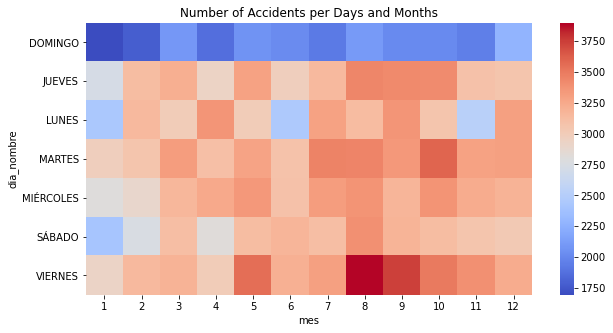

In [27]:
pivot_day_month = df.pivot_table(index='dia_nombre',columns='mes', values="radicado", aggfunc=lambda x: x.count())
fig, ax = plt.subplots(figsize=(10, 5))
sns.heatmap(pivot_day_month, cmap="coolwarm", ax=ax)
ax.set_title("Number of Accidents per Days and Months")

Text(0.5, 1.0, 'Number of Accidents per Days')

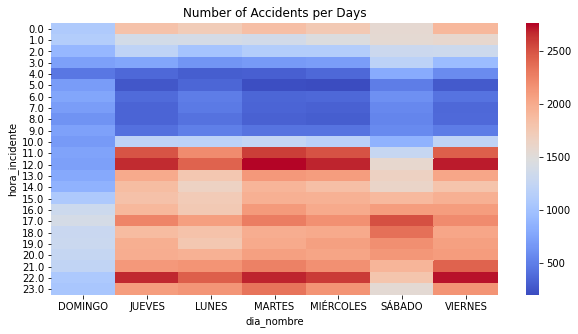

In [28]:
pivot_hours_day = df.pivot_table(index='hora_incidente',columns='dia_nombre', values="radicado", aggfunc=lambda x: x.count())
fig, ax = plt.subplots(figsize=(10, 5))
sns.heatmap(pivot_hours_day, cmap="coolwarm", ax=ax)
ax.set_title("Number of Accidents per Days")

In [29]:
list(df.dia_nombre.unique())

['MIÉRCOLES', 'JUEVES', 'VIERNES', 'SÁBADO', 'DOMINGO', 'LUNES', 'MARTES']

([<matplotlib.axis.XTick at 0x12b854450>,
 <a list of 12 Text major ticklabel objects>)

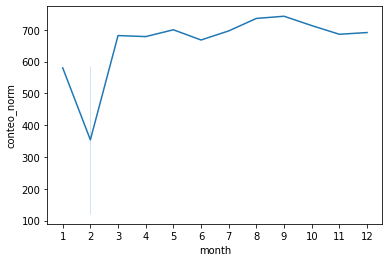

In [31]:
df2 = df
df2["daysinmonth"] = df2.fecha_dt.dt.daysinmonth
df2["month"] = df2.fecha_dt.dt.month
group = df.groupby(["month", "daysinmonth"])["radicado"].count().reset_index(name="conteo")
# Normalize the number of accidents according to days per month
group["conteo_norm"] = group.conteo / group.daysinmonth
sns.lineplot(x=group.month, y=group.conteo_norm)
plt.xticks(list(range(1,13,1)))

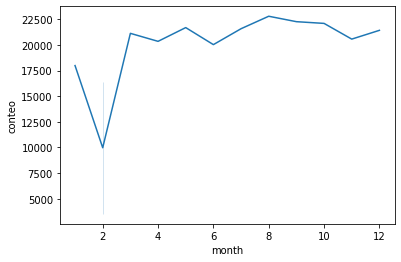

In [32]:
sns.lineplot(x=group.month, y=group.conteo)

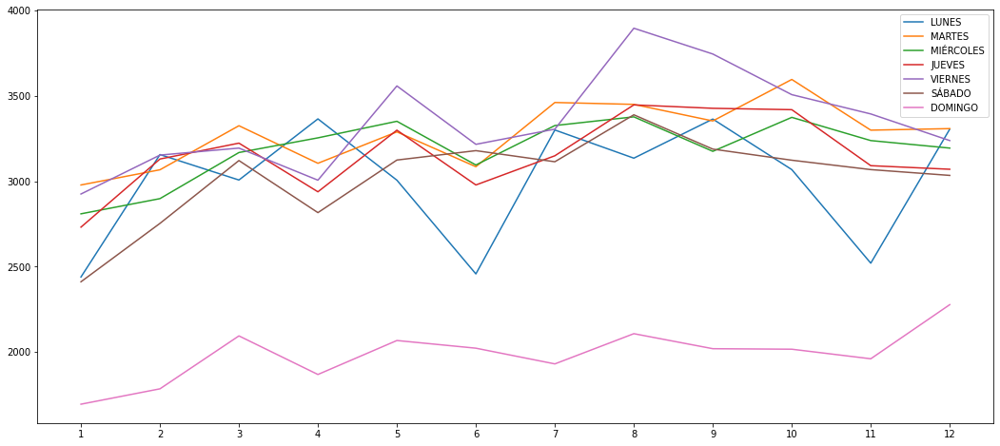

In [33]:
plt.figure(figsize = (18, 8))
dias_nombre = ['LUNES', 'MARTES', 'MIÉRCOLES', 'JUEVES', 'VIERNES', 'SÁBADO', 'DOMINGO']#list(df.dia_nombre.unique())
for day in dias_nombre:
    group = df[(df.dia_nombre == day)].groupby("mes")["fecha_dt"].count().reset_index(name="conteo")
    plt.plot(group.mes, group.conteo)
plt.xticks(list(range(1,13,1)))
plt.legend(dias_nombre)

In [34]:
list(zip(['CRIM_SEXUAL_ASSAULT', 'ARSON', 'HOMICIDE'], [10] * 4))

[('CRIM_SEXUAL_ASSAULT', 10), ('ARSON', 10), ('HOMICIDE', 10)]

In [35]:
for a in zip(['MOTOR VEHICLE THEFT', 'PUBLIC PEACE VIOLATION',  'CRIMINAL DAMAGE'], [8] * 3):
    print(a)

('MOTOR VEHICLE THEFT', 8)
('PUBLIC PEACE VIOLATION', 8)
('CRIMINAL DAMAGE', 8)


In [36]:
beat_cn = df.groupby("cbml")["radicado"].count().reset_index(name="accidents_count")

In [37]:
min_cn, max_cn = beat_cn['accidents_count'].quantile([0.01,0.99]).apply(round, 2)

colormap = branca.colormap.LinearColormap(
    colors=['white','yellow','orange','red','darkred'],
    #index=beat_cn['count'].quantile([0.2,0.4,0.6,0.8]),b
    vmin=min_cn,
    vmax=max_cn
)

colormap.caption="Total Accidents in Medellin by borough"

In [38]:
beat_orig = geopandas.read_file("./Barrios.geojson", driver = "GeoJSON")
#beat_data = beat_orig.join(beat_cn.set_index("beat_num"), how = "left", on = "beat_num")
#beat_data.fillna(0, inplace = True)
beat_orig

,OBJECTID,SHAPEAREA,SHAPELEN,COMUNA,BARRIO,CODIGO,NOMBRE_BARRIO,NOMBRE_COMUNA,geometry
0,59,8.215087e+04,1798.515505,09,01,0901,Juan Pablo II,BUENOS AIRES,"POLYGON ((-75.52800 6.22910, -75.52800 6.22909..."
1,60,1.155909e+06,5941.311834,14,09,1409,El Tesoro,EL POBLADO,"POLYGON ((-75.55281 6.20736, -75.55295 6.20737..."
2,61,3.493559e+05,2671.218669,12,11,1211,Simón Bolívar,LA AMERICA,"POLYGON ((-75.60275 6.24335, -75.60274 6.24393..."
3,62,5.809746e+05,3619.313674,06,04,0604,Pedregal,DOCE DE OCTUBRE,"POLYGON ((-75.57011 6.30035, -75.57006 6.30044..."
4,4,1.138027e+07,26985.855494,90,08,9008,Piedras Blancas,SANTA ELENA,"POLYGON ((-75.52466 6.28815, -75.52469 6.28815..."
...,...,...,...,...,...,...,...,...,...
345,290,2.048820e+05,3546.201127,02,02,0202,Playón de Los Comuneros,SANTA CRUZ,"POLYGON ((-75.55292 6.30747, -75.55298 6.30747..."
346,291,3.659147e+05,2977.786878,11,12,1112,El Velódromo,LAURELES,"POLYGON ((-75.59581 6.25820, -75.59603 6.25824..."
347,292,1.628053e+05,1874.051286,16,19,1619,Miravalle,BELEN,"POLYGON ((-75.59860 6.23613, -75.59885 6.23616..."
348,293,3.893528e+05,3111.744441,03,03,0303,Campo Valdés No. 2,MANRIQUE,"POLYGON ((-75.55166 6.27677, -75.55185 6.27680..."


In [39]:
beat_orig = geopandas.read_file("./Barrios.geojson", driver = "GeoJSON")
beat_data = beat_orig.merge(beat_cn, how = "left", left_on = "CODIGO", right_on="cbml")
beat_data.fillna(0, inplace = True)


In [40]:
m_crime = folium.Map(location=[6.2443382, -75.5735530],  
                        zoom_start=12,
                        tiles="OpenStreetMap")
style_function = lambda x: {
    'fillColor': colormap(x['properties']['accidents_count']),
    'color': 'black',
    'weight':2,
    'fillOpacity':0.5
}

stategeo = folium.GeoJson(
    beat_data.to_json(),
    name='Chicago beats',
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['cbml', 'NOMBRE_BARRIO', 'accidents_count'],
        aliases=['Beat', 'Borough' ,'Total accidents'], 
        localize=True
    )
).add_to(m_crime)

colormap.add_to(m_crime)
m_crime

In [43]:
df[(df.cbml.isna()) & (df.direccion_enc != '000')].head(5)

,x,y,objectid,radicado,fecha,hora,dia,periodo,clase,direccion,direccion_enc,cbml,tipo_geocod,gravedad,barrio,comuna,diseno,dia_nombre,mes,mes_nombre,x_magnamed,y_magnamed,longitud,latitud,file,shape,fecha_incidente,hora_incidente,fecha_dt,festivo,daysinmonth,month
1311,-75.581203,6.195227,212779,1425469,2014/01/16 00:00:00+00,05:00:00,16,2014,Caída de Ocupante,CL 12 sur CR 49,CL S 012 049 000 00000,NaN,Malla vial,HERIDO,NaN,Sin Inf,Tramo de via,JUEVES,1,NaN,833572.49,1177058.05,-75.581203,6.195227,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-16,22.0,2014-01-16 00:00:00+00:00,0,31,1
1584,-75.581203,6.195227,213086,1425837,2014/01/18 00:00:00+00,02:10:00,18,2014,Choque,CL 12 sur CR 49,CL S 012 049 000 00000,NaN,Malla vial,SOLO DAÑOS,NaN,Sin Inf,Interseccion,SÁBADO,1,NaN,833572.49,1177058.05,-75.581203,6.195227,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-18,19.0,2014-01-18 00:00:00+00:00,0,31,1
2155,-75.581203,6.195227,213756,1426363,2014/01/24 00:00:00+00,06:30:00,24,2014,Choque,CL 12 sur CR 49,CL S 012 049 000 00000,NaN,Malla vial,SOLO DAÑOS,NaN,Sin Inf,Interseccion,VIERNES,1,NaN,833572.49,1177058.05,-75.581203,6.195227,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-24,11.0,2014-01-24 00:00:00+00:00,0,31,1
2834,-75.581654,6.195355,214526,1427362,2014/01/30 00:00:00+00,01:00:00,30,2014,Choque,CL 12 sur CR 50,CL S 012 050 000 00000,NaN,Malla vial,SOLO DAÑOS,NaN,Sin Inf,Puente,JUEVES,1,NaN,833522.52,1177072.25,-75.581654,6.195355,Accidentalidadgeorreferenciada2014.csv,NaN,2014-01-30,18.0,2014-01-30 00:00:00+00:00,0,31,1
3093,-75.581654,6.195355,214811,1427607,2014/02/01 00:00:00+00,10:30:00,1,2014,Choque,CL 12 sur CR 50,CL S 012 050 000 00000,NaN,Malla vial,SOLO DAÑOS,NaN,Sin Inf,Tramo de via,SÁBADO,2,NaN,833522.52,1177072.25,-75.581654,6.195355,Accidentalidadgeorreferenciada2014.csv,NaN,2014-02-01,15.0,2014-02-01 00:00:00+00:00,0,28,2
